<a href="https://colab.research.google.com/github/reekithak/Tensorflow-OpenCv-Keras/blob/master/CustomRun_YoloV5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -U -r yolov5/requirements.txt  # install dependencies

%cd /content/yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 5839, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 5839 (delta 29), reused 36 (delta 14), pack-reused 5770
Receiving objects: 100% (5839/5839), 8.36 MiB | 35.53 MiB/s, done.
Resolving deltas: 100% (3972/3972), done.
     |████████████████████████████████| 10.3MB 15.7MB/s 
     |████████████████████████████████| 15.3MB 186kB/s 
     |████████████████████████████████| 50.4MB 60kB/s 
     |████████████████████████████████| 3.0MB 51.0MB/s 
     |████████████████████████████████| 645kB 51.5MB/s 
     |████████████████████████████████| 27.4MB 113kB/s 
Requirement already up-to-date: torch>=1.7.0 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 10)) (1.8.1+cu101)
Requirement already up-to-date: torchvision>=0.8.1 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 11)) (0.9.1+cu101)
     |██████████████████████

/content/yolov5


In [2]:
import torch
from IPython.display import Image  # for displaying images
from utils.google_utils import gdrive_download  # for downloading models/datasets

print('torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [3]:
!curl -L "https://app.roboflow.com/ds/9jWZPm5Sz8?key=2EZ4Mr1onN" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
 extracting: train/images/smoke--676-_jpg.rf.be129a59df11dbcd7a5d0d840ba8cb53.jpg  
 extracting: train/images/smoke--676-_jpg.rf.ecd1678f142878e4c987c09bbdb9da91.jpg  
 extracting: train/images/smoke--677-_jpg.rf.42c8b594c4629be94b77733a967f9dd0.jpg  
 extracting: train/images/smoke--677-_jpg.rf.76188415b081e7320d905b15efe695d7.jpg  
 extracting: train/images/smoke--677-_jpg.rf.a6a39d5f9239087c1a15986a6853b5f8.jpg  
 extracting: train/images/smoke--678-_jpg.rf.120854297a2b3f899c8af12b935bd339.jpg  
 extracting: train/images/smoke--678-_jpg.rf.6ac7d833c8ccc961a86f7d767504968d.jpg  
 extracting: train/images/smoke--678-_jpg.rf.a89a635e988211f85ed5a8e966f562da.jpg  
 extracting: train/images/smoke--680-_jpg.rf.0bed06d0a292e3e83cbc10d2f09614b2.jpg  
 extracting: train/images/smoke--680-_jpg.rf.0caab267a4fd39c3b5f5422a07800e55.jpg  
 extracting: train/images/smoke--680-_jpg.rf.2d9e85405479fa8c720d2aec5abc1960.jpg  
 extracting: train/images

In [4]:
ls


data/       hubconf.py  README.roboflow.txt  train/          valid/
data.yaml   LICENSE     requirements.txt*    train.py        weights/
detect.py   models/     test/                tutorial.ipynb
Dockerfile  README.md*  test.py              utils/


In [6]:
ls

custom_yolov5s.yaml  Dockerfile  README.md*           test.py         utils/
data/                hubconf.py  README.roboflow.txt  train/          valid/
data.yaml            LICENSE     requirements.txt*    train.py        weights/
detect.py            models/     test/                tutorial.ipynb


In [8]:
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 2
names: ['fire', 'smoke']

In [10]:
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [11]:
num_classes

'2'

In [12]:
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [13]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [14]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [15]:
ls

data/       hubconf.py  README.roboflow.txt  train/          valid/
data.yaml   LICENSE     requirements.txt*    train.py        weights/
detect.py   models/     test/                tutorial.ipynb
Dockerfile  README.md*  test.py              utils/


In [20]:
%%time
%cd /content/yolov5/
!python train.py --img 312 --batch 16 --epochs 10 --data '/content/yolov5/data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name new_yolo_res --nosave --cache

/content/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-19-g5f7d39f torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='/content/yolov5/data.yaml', device='', entity=None, epochs=10, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[312, 312], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='new_yolo_res', noautoanchor=False, nosave=True, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/new_yolo_res4', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-04-21 21:43:09.484367: I tensorflow/stream_executor/

In [21]:
%load_ext tensorboard
%tensorboard --logdir runs


<IPython.core.display.Javascript object>

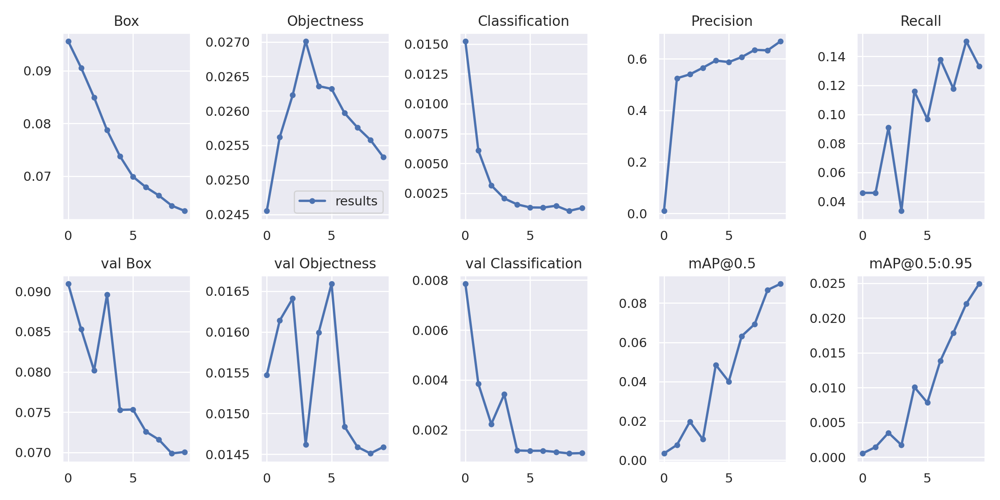

In [25]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/new_yolo_res4/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


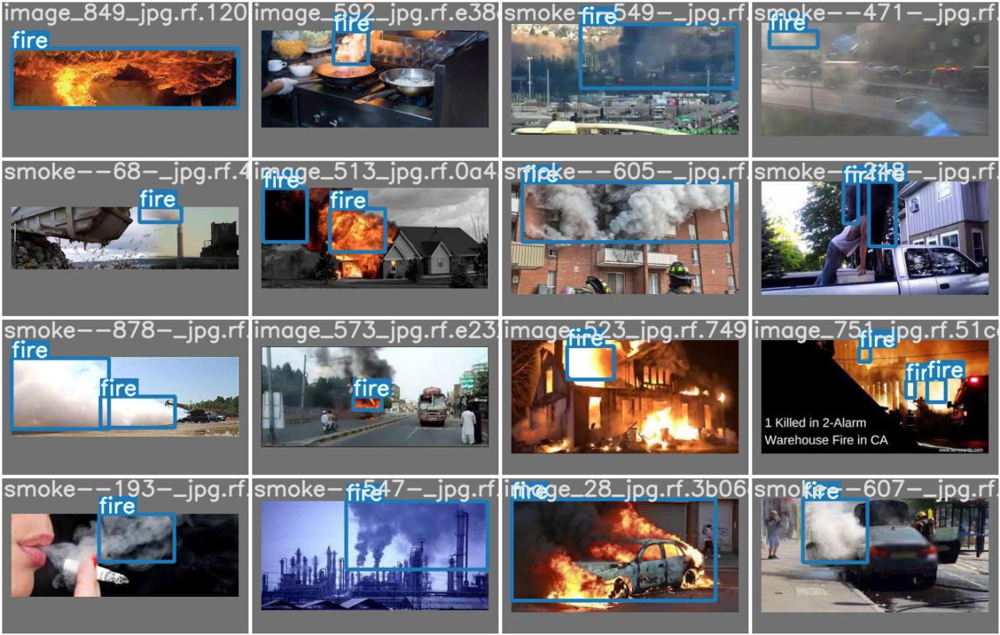

In [26]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/new_yolo_res4/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


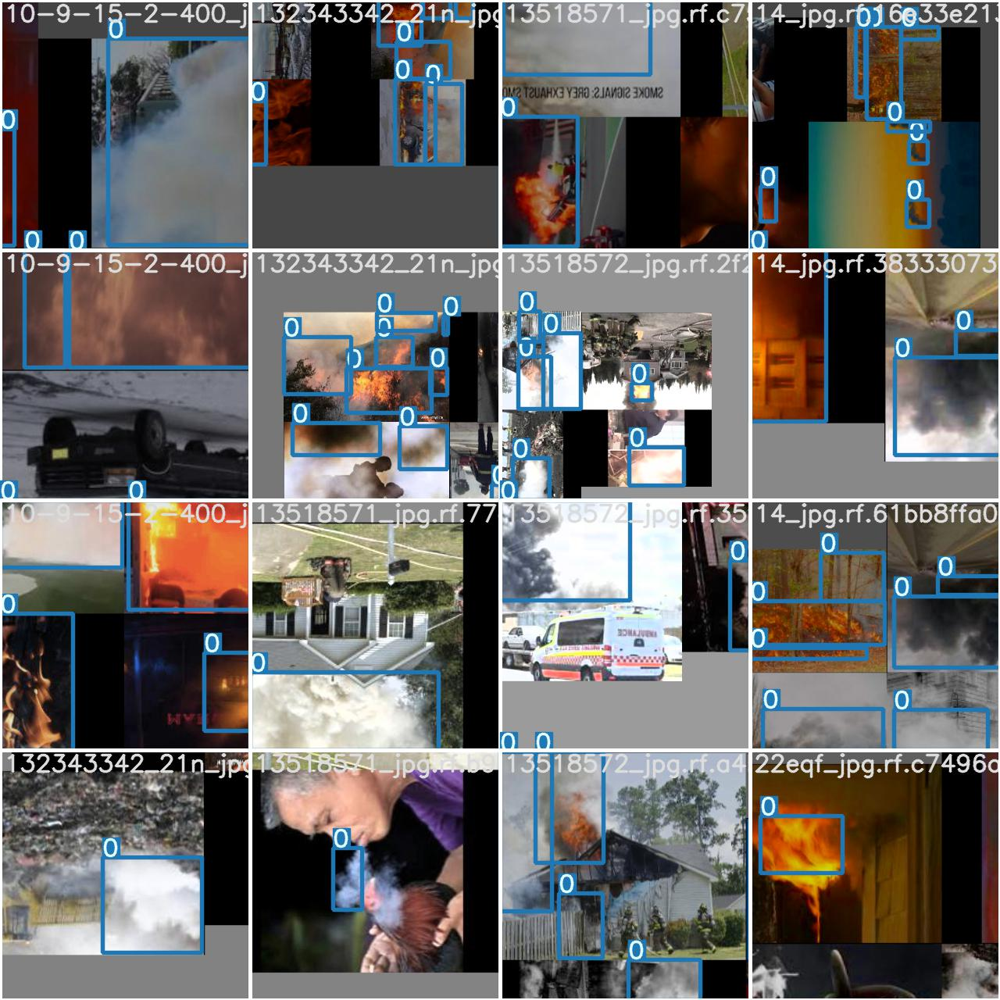

In [27]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/new_yolo_res4/train_batch0.jpg', width=900)

In [28]:
%ls weights/

download_weights.sh*


In [29]:
pwd

'/content/yolov5'

In [32]:
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/new_yolo_res4/weights/best.pt --img 416 --conf 0.1 --source /content/yolov5/test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.1, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/yolov5/test/images', update=False, view_img=False, weights=['/content/yolov5/runs/train/new_yolo_res4/weights/best.pt'])
YOLOv5 🚀 v5.0-19-g5f7d39f torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 232 layers, 7249215 parameters, 0 gradients, 16.8 GFLOPS
image 1/179 /content/yolov5/test/images/1_jpg.rf.8f27a2eed1a3b347ba683061f0d43c62.jpg: 256x416 2 fires, Done. (0.010s)
image 2/179 /content/yolov5/test/images/913_0_jpg.rf.0b89e43c9c851e544f6ef2f8fcfeb2eb.jpg: 288x416 2 fires, Done. (0.009s)
image 3/179 /content/yolov5/test/images/burning-house2_jpg.rf.c3e3e2108b7cae193c6fa86e1e2f7602.jpg: 288x416 5 fires, Done. (0.008s)
image 4/179 /content/yolov5/test/images/dsc_01001_jpg.rf.36045a6310f7b533023

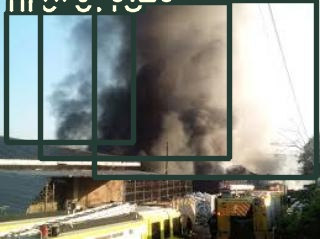

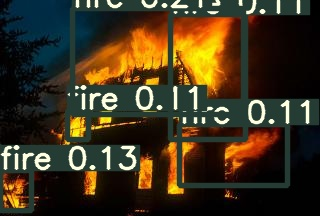

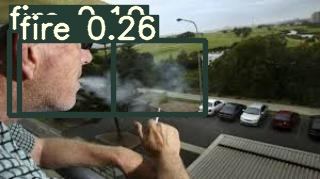

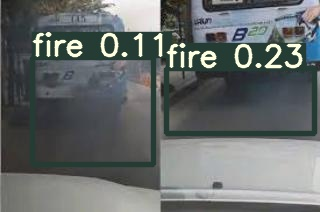

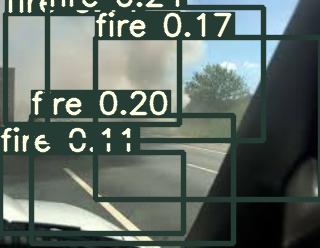

...

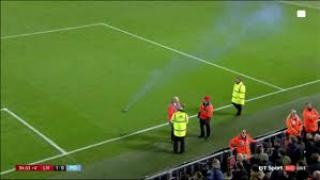

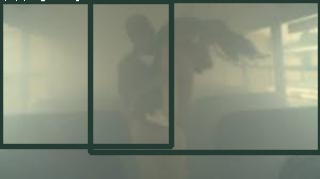

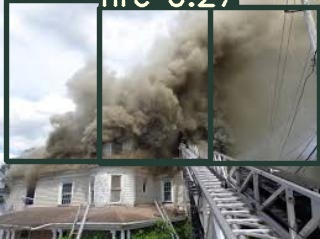

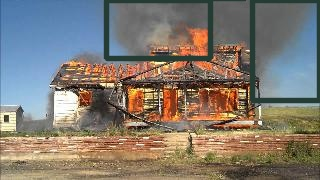

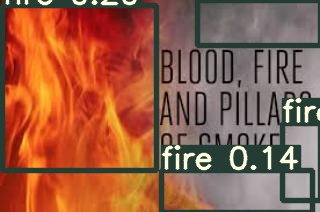

In [33]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [34]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [35]:
%cp /content/yolov5/runs/train/new_yolo_res4/weights/best.pt /content/gdrive/My\ Drive